# Credit Card Clients Dataset

## Import Libraries

In [114]:
import numpy as np
import pandas as pd
import re
#for EDA
from ydata_profiling import ProfileReport

#for visualization
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

#for preprocessing
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler, OrdinalEncoder, OneHotEncoder

#for model
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier as knn
from sklearn.naive_bayes import GaussianNB as nb
from sklearn.linear_model import LogisticRegression as lr
from sklearn.tree import DecisionTreeClassifier as dt 
from sklearn.svm import SVC as vc
from sklearn.ensemble import RandomForestClassifier as rcl
import sklearn.metrics as sm

## Loading the Dataset

### Importing data

In [115]:
Credit_data = pd.read_csv('data/default of credit card clients.csv', skiprows=[0])
Credit_data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


Drop column 'ID' since it has no impact on the model performance.

In [116]:
Credit_data.drop('ID', axis = 1, inplace=True)

I will rename some columns for the ease of further analysis.

In [117]:
Credit_data.rename(columns={'PAY_0':'PAY_SEPT','PAY_2':'PAY_AUG','PAY_3':'PAY_JUL','PAY_4':'PAY_JUN','PAY_5':'PAY_MAY','PAY_6':'PAY_APR'},inplace=True)
Credit_data.rename(columns={'BILL_AMT1':'BILL_AMT_SEPT','BILL_AMT2':'BILL_AMT_AUG','BILL_AMT3':'BILL_AMT_JUL','BILL_AMT4':'BILL_AMT_JUN','BILL_AMT5':'BILL_AMT_MAY','BILL_AMT6':'BILL_AMT_APR'}, inplace = True)
Credit_data.rename(columns={'PAY_AMT1':'PAY_AMT_SEPT','PAY_AMT2':'PAY_AMT_AUG','PAY_AMT3':'PAY_AMT_JUL','PAY_AMT4':'PAY_AMT_JUN','PAY_AMT5':'PAY_AMT_MAY','PAY_AMT6':'PAY_AMT_APR'},inplace=True)


In [118]:
Credit_data.describe().T

,count,mean,std,min,25%,50%,75%,max
LIMIT_BAL,30000.0,167484.322667,129747.661567,10000.0,50000.00,140000.0,240000.00,1000000.0
SEX,30000.0,1.603733,0.489129,1.0,1.00,2.0,2.00,2.0
EDUCATION,30000.0,1.853133,0.790349,0.0,1.00,2.0,2.00,6.0
MARRIAGE,30000.0,1.551867,0.521970,0.0,1.00,2.0,2.00,3.0
AGE,30000.0,35.485500,9.217904,21.0,28.00,34.0,41.00,79.0
PAY_SEPT,30000.0,-0.016700,1.123802,-2.0,-1.00,0.0,0.00,8.0
PAY_AUG,30000.0,-0.133767,1.197186,-2.0,-1.00,0.0,0.00,8.0
PAY_JUL,30000.0,-0.166200,1.196868,-2.0,-1.00,0.0,0.00,8.0
PAY_JUN,30000.0,-0.220667,1.169139,-2.0,-1.00,0.0,0.00,8.0
PAY_MAY,30000.0,-0.266200,1.133187,-2.0,-1.00,0.0,0.00,8.0


In [119]:
Credit_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   LIMIT_BAL                   30000 non-null  int64
 1   SEX                         30000 non-null  int64
 2   EDUCATION                   30000 non-null  int64
 3   MARRIAGE                    30000 non-null  int64
 4   AGE                         30000 non-null  int64
 5   PAY_SEPT                    30000 non-null  int64
 6   PAY_AUG                     30000 non-null  int64
 7   PAY_JUL                     30000 non-null  int64
 8   PAY_JUN                     30000 non-null  int64
 9   PAY_MAY                     30000 non-null  int64
 10  PAY_APR                     30000 non-null  int64
 11  BILL_AMT_SEPT               30000 non-null  int64
 12  BILL_AMT_AUG                30000 non-null  int64
 13  BILL_AMT_JUL                30000 non-null  int64
 14  BILL_A

In [120]:
Credit_data.duplicated().sum()

35

In [121]:
Credit_data = Credit_data.drop_duplicates()

In [122]:
Credit_data.isna().sum()

LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_SEPT                      0
PAY_AUG                       0
PAY_JUL                       0
PAY_JUN                       0
PAY_MAY                       0
PAY_APR                       0
BILL_AMT_SEPT                 0
BILL_AMT_AUG                  0
BILL_AMT_JUL                  0
BILL_AMT_JUN                  0
BILL_AMT_MAY                  0
BILL_AMT_APR                  0
PAY_AMT_SEPT                  0
PAY_AMT_AUG                   0
PAY_AMT_JUL                   0
PAY_AMT_JUN                   0
PAY_AMT_MAY                   0
PAY_AMT_APR                   0
default payment next month    0
dtype: int64

### Data Dictionary

1. Categorical Attributes

In this dataset, categorical columns have been encoded so I will list them by hands.

In [123]:
categorical_columns = ['SEX', 'EDUCATION', 'MARRIAGE', 'PAY_SEPT', 'PAY_AUG', 'PAY_JUL', 'PAY_JUN', 'PAY_MAY', 'PAY_APR']
categorical_columns

['SEX',
 'EDUCATION',
 'MARRIAGE',
 'PAY_SEPT',
 'PAY_AUG',
 'PAY_JUL',
 'PAY_JUN',
 'PAY_MAY',
 'PAY_APR']

2. Numerical Attributes

In [124]:
numerical_columns = list(set(Credit_data.columns) - set(categorical_columns))
numerical_columns.remove('default payment next month')
numerical_columns

['PAY_AMT_JUL',
 'PAY_AMT_SEPT',
 'PAY_AMT_APR',
 'BILL_AMT_APR',
 'BILL_AMT_MAY',
 'AGE',
 'PAY_AMT_JUN',
 'BILL_AMT_JUL',
 'BILL_AMT_SEPT',
 'BILL_AMT_JUN',
 'LIMIT_BAL',
 'PAY_AMT_MAY',
 'PAY_AMT_AUG',
 'BILL_AMT_AUG']

## Data Exploration and Visualization

In [125]:
profile = ProfileReport(Credit_data, title = "Pandas Profiling Report for Credit card Clients dataset")
profile.to_file(output_file="Credit_profiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [126]:
profile

### Categorical Column Analysis

#### EDUCATION

According to Dataset description, the categories 0, 4, 5, 6 are either unknowns or belong to others. We can group them into a single category named '4', which represents 'others'.

In [127]:
Credit_data['EDUCATION'].loc[np.logical_or(Credit_data['EDUCATION'] == 0, np.logical_or(Credit_data['EDUCATION'] == 5, Credit_data['EDUCATION'] == 6))] = 4
Credit_data['EDUCATION'].unique()

array([2, 1, 3, 4], dtype=int64)

##### MARRIAGE

Same with 'EDUCATION' columns, the column 'MARRIAGE' should only have three values: 1 = married, 2 = single, 3 = others, but there is an unexpected value of 0. I will join it to 3 as others

In [128]:
Credit_data['MARRIAGE'].loc[Credit_data['MARRIAGE'] == 0] = 3
Credit_data['MARRIAGE'].unique()

array([1, 2, 3], dtype=int64)

### Numerical Column Analysis

In [129]:
numerical_columns

['PAY_AMT_JUL',
 'PAY_AMT_SEPT',
 'PAY_AMT_APR',
 'BILL_AMT_APR',
 'BILL_AMT_MAY',
 'AGE',
 'PAY_AMT_JUN',
 'BILL_AMT_JUL',
 'BILL_AMT_SEPT',
 'BILL_AMT_JUN',
 'LIMIT_BAL',
 'PAY_AMT_MAY',
 'PAY_AMT_AUG',
 'BILL_AMT_AUG']

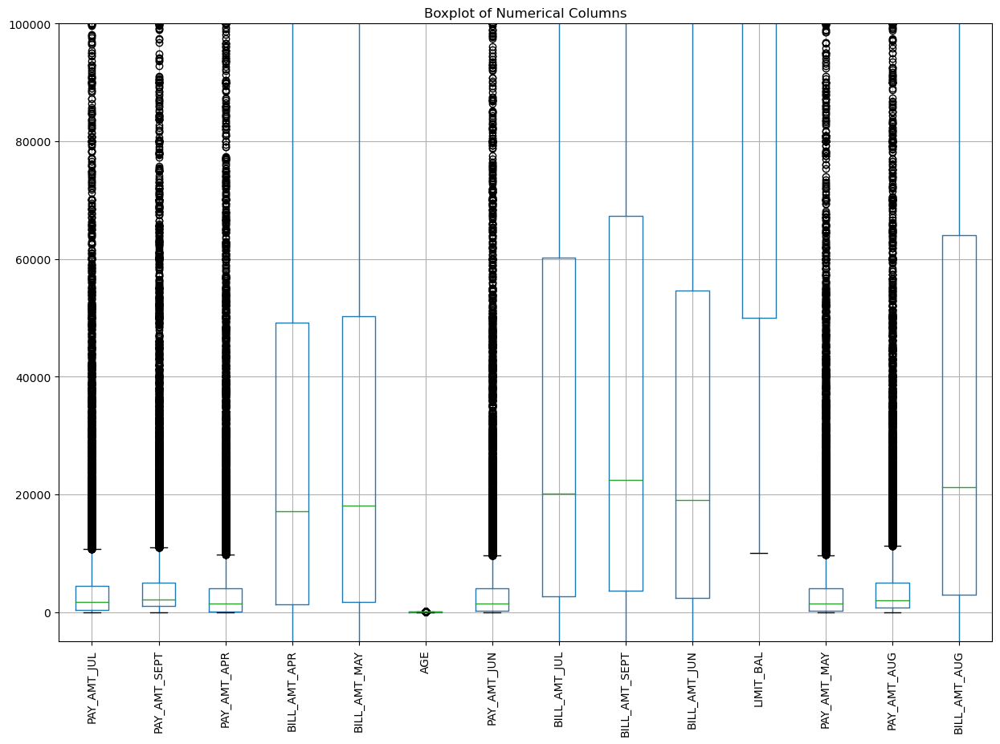

In [131]:
plt.figure(figsize=(15,10))
ax = Credit_data.boxplot(column= numerical_columns)
plt.title("Boxplot of Numerical Columns")
ax.set_ylim([-5000, 100000])
plt.xticks(rotation=90)
plt.show()

The boxplot shows that features are in different scales and units. In this case, we should use Standard Scaling.

We cannot apply IQR method for outliers elimination in this scenario because most of these numerical columns's values are zeros

## Data Preprocessing

In [132]:
Credit_data

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_SEPT,PAY_AUG,PAY_JUL,PAY_JUN,PAY_MAY,...,BILL_AMT_JUN,BILL_AMT_MAY,BILL_AMT_APR,PAY_AMT_SEPT,PAY_AMT_AUG,PAY_AMT_JUL,PAY_AMT_JUN,PAY_AMT_MAY,PAY_AMT_APR,default payment next month
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,1,3,1,39,0,0,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,150000,1,3,2,43,-1,-1,-1,-1,0,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,30000,1,2,2,37,4,3,2,-1,0,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,80000,1,3,1,41,1,-1,0,0,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [133]:
Credit_data.replace({'SEX': {1 : 'male', 2 : 'female'}, 'EDUCATION' : {1 : 'graduate school', 2 : 'university', 3 : 'high school', 4 : 'others'}, 'MARRIAGE' : {1 : 'married', 2 : 'single', 3 : 'others'}}, inplace = True)

### Encoding the Data

#### Encoding as Binary

In [134]:
mapping = {"male": 0, "female": 1}
Credit_data['SEX'] = Credit_data['SEX'].map(mapping)

#### One Hot Encoding

In [135]:
ohe = ['MARRIAGE', 'EDUCATION']
Credit_data = pd.get_dummies(Credit_data, columns=ohe, dtype=np.int64)

In [136]:
Credit_data = pd.get_dummies(Credit_data, columns=['PAY_SEPT', 'PAY_AUG', 'PAY_JUL', 'PAY_JUN', 'PAY_MAY', 'PAY_APR'], dtype=np.int64, drop_first=True)

### Scaling the Data

#### Standard Scaling

In [137]:
numerical_columns

['PAY_AMT_JUL',
 'PAY_AMT_SEPT',
 'PAY_AMT_APR',
 'BILL_AMT_APR',
 'BILL_AMT_MAY',
 'AGE',
 'PAY_AMT_JUN',
 'BILL_AMT_JUL',
 'BILL_AMT_SEPT',
 'BILL_AMT_JUN',
 'LIMIT_BAL',
 'PAY_AMT_MAY',
 'PAY_AMT_AUG',
 'BILL_AMT_AUG']

In [138]:
Standard_scaler = StandardScaler()
Credit_data[numerical_columns] = Standard_scaler.fit_transform(Credit_data[numerical_columns])

## Model Building

In [139]:
Credit_data

,LIMIT_BAL,SEX,AGE,BILL_AMT_SEPT,BILL_AMT_AUG,BILL_AMT_JUL,BILL_AMT_JUN,BILL_AMT_MAY,BILL_AMT_APR,PAY_AMT_SEPT,...,PAY_MAY_8,PAY_APR_-1,PAY_APR_0,PAY_APR_2,PAY_APR_3,PAY_APR_4,PAY_APR_5,PAY_APR_6,PAY_APR_7,PAY_APR_8
0,-1.136285,1,-1.246078,-0.643117,-0.648006,-0.668571,-0.673064,-0.663612,-0.653264,-0.342158,...,0,0,0,0,0,0,0,0,0,0
1,-0.365619,1,-1.029141,-0.659830,-0.667347,-0.639841,-0.622219,-0.606802,-0.598525,-0.342158,...,0,0,0,1,0,0,0,0,0,0
2,-0.596819,1,-0.161397,-0.299280,-0.494553,-0.483045,-0.450369,-0.417822,-0.392257,-0.250556,...,0,0,1,0,0,0,0,0,0,0
3,-0.905085,1,0.164007,-0.058284,-0.014093,0.032047,-0.233081,-0.187439,-0.157286,-0.221470,...,0,0,1,0,0,0,0,0,0,0
4,-0.905085,0,2.333368,-0.579253,-0.611935,-0.161927,-0.347669,-0.348795,-0.332130,-0.221470,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,0.405046,0,0.380943,1.869003,2.016713,2.325164,0.694467,-0.149982,-0.385023,0.170768,...,0,0,1,0,0,0,0,0,0,0
29996,-0.134420,0,0.814815,-0.673393,-0.665900,-0.628021,-0.533536,-0.578273,-0.653264,-0.231306,...,0,0,1,0,0,0,0,0,0,0
29997,-1.059218,0,0.164007,-0.647842,-0.644438,-0.638746,-0.348632,-0.325182,-0.328336,-0.342158,...,0,0,1,0,0,0,0,0,0,0
29998,-0.673885,0,0.597879,-0.718575,0.409339,0.421450,0.147013,-0.468681,0.168314,4.841417,...,0,1,0,0,0,0,0,0,0,0


In [140]:
features = Credit_data[Credit_data.columns.difference(['default payment next month'])]
target = Credit_data['default payment next month']
features

,AGE,BILL_AMT_APR,BILL_AMT_AUG,BILL_AMT_JUL,BILL_AMT_JUN,BILL_AMT_MAY,BILL_AMT_SEPT,EDUCATION_graduate school,EDUCATION_high school,EDUCATION_others,...,PAY_SEPT_0,PAY_SEPT_1,PAY_SEPT_2,PAY_SEPT_3,PAY_SEPT_4,PAY_SEPT_5,PAY_SEPT_6,PAY_SEPT_7,PAY_SEPT_8,SEX
0,-1.246078,-0.653264,-0.648006,-0.668571,-0.673064,-0.663612,-0.643117,0,0,0,...,0,0,1,0,0,0,0,0,0,1
1,-1.029141,-0.598525,-0.667347,-0.639841,-0.622219,-0.606802,-0.659830,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,-0.161397,-0.392257,-0.494553,-0.483045,-0.450369,-0.417822,-0.299280,0,0,0,...,1,0,0,0,0,0,0,0,0,1
3,0.164007,-0.157286,-0.014093,0.032047,-0.233081,-0.187439,-0.058284,0,0,0,...,1,0,0,0,0,0,0,0,0,1
4,2.333368,-0.332130,-0.611935,-0.161927,-0.347669,-0.348795,-0.579253,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,0.380943,-0.385023,2.016713,2.325164,0.694467,-0.149982,1.869003,0,1,0,...,1,0,0,0,0,0,0,0,0,0
29996,0.814815,-0.653264,-0.665900,-0.628021,-0.533536,-0.578273,-0.673393,0,1,0,...,0,0,0,0,0,0,0,0,0,0
29997,0.164007,-0.328336,-0.644438,-0.638746,-0.348632,-0.325182,-0.647842,0,0,0,...,0,0,0,0,1,0,0,0,0,0
29998,0.597879,0.168314,0.409339,0.421450,0.147013,-0.468681,-0.718575,0,1,0,...,0,1,0,0,0,0,0,0,0,0


### Train-test splitting

In [141]:
feature_train, feature_test, label_train, label_test = train_test_split(features, target, test_size=0.2, random_state=42)

### Model

#### Accuracy calculating

In [142]:
def calc_accuracy(method, label_test, pred):
  print("accuracy score for ", method, sm.accuracy_score(label_test,pred))
  print("precision_score for ", method, sm.precision_score(label_test,pred,average='micro'))
  print("f1 score for ", method, sm.f1_score(label_test,pred,average='micro'))
  print("recall score for ", method, sm.recall_score(label_test,pred,average='micro'))
  accuracy = sm.accuracy_score(label_test,pred)
  return accuracy

#### Logistic Regression

In [163]:
clf = lr(max_iter=350)
clf.fit(feature_train, label_train)

LogisticRegression(max_iter=350)

In [144]:
pred = clf.predict(feature_test)
lr_accuracy = calc_accuracy("Logistic Regression", label_test, pred)

accuracy score for  Logistic Regression 0.8166193892875021
precision_score for  Logistic Regression 0.8166193892875021
f1 score for  Logistic Regression 0.8166193892875021
recall score for  Logistic Regression 0.8166193892875021


#### Gaussian Naive Bayes

In [145]:
clf = nb()
clf.fit(feature_train, label_train)

GaussianNB()

In [146]:
pred = clf.predict(feature_test)
nb_accuracy = calc_accuracy("Gaussian Naive Bayes", label_test, pred)

accuracy score for  Gaussian Naive Bayes 0.7897547138328049
precision_score for  Gaussian Naive Bayes 0.7897547138328049
f1 score for  Gaussian Naive Bayes 0.7897547138328049
recall score for  Gaussian Naive Bayes 0.7897547138328049


#### Linear Support Vector Machine

In [147]:
clf = vc(C=10, gamma=0.1, kernel='rbf')
clf.fit(feature_train, label_train)

SVC(C=10, gamma=0.1)

In [148]:
pred = clf.predict(feature_test)
svc_accuracy = calc_accuracy("SVC", label_test, pred)

accuracy score for  SVC 0.8116135491406641
precision_score for  SVC 0.8116135491406641
f1 score for  SVC 0.8116135491406641
recall score for  SVC 0.8116135491406641


#### K-Nearest Neighbors

In [149]:
clf = knn(n_neighbors=25)
clf.fit(feature_train, label_train)

KNeighborsClassifier(n_neighbors=25)

In [150]:
pred = clf.predict(feature_test.values)
knn_accuracy = calc_accuracy("KNN", label_test, pred)

c:\Users\Storm\anaconda3\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


accuracy score for  KNN 0.8074420156849658
precision_score for  KNN 0.8074420156849658
f1 score for  KNN 0.8074420156849658
recall score for  KNN 0.8074420156849658


#### Decision Tree Classifier

In [151]:
clf = dt(min_impurity_decrease=0.05)
clf.fit(feature_train, label_train)

DecisionTreeClassifier(min_impurity_decrease=0.05)

In [152]:
pred = clf.predict(feature_test)
dt_accuracy = calc_accuracy("Decision Tree Classifer", label_test, pred)

accuracy score for  Decision Tree Classifer 0.779743033539129
precision_score for  Decision Tree Classifer 0.779743033539129
f1 score for  Decision Tree Classifer 0.779743033539129
recall score for  Decision Tree Classifer 0.779743033539129


## Evaluation

<function matplotlib.pyplot.show(close=None, block=None)>

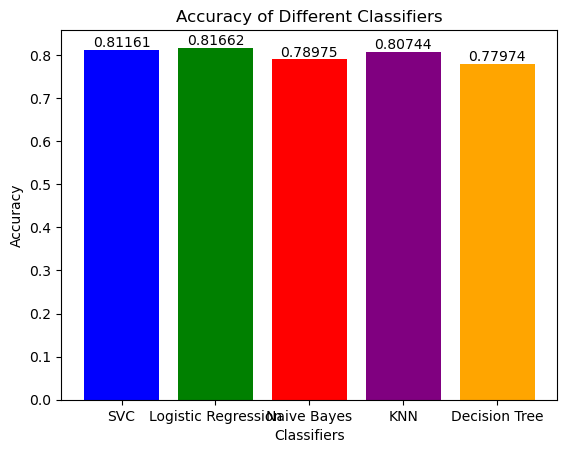

In [153]:
algorithms = ["SVC", "Logistic Regression", "Naive Bayes", "KNN", "Decision Tree"]
accuracy = [svc_accuracy, lr_accuracy, nb_accuracy, knn_accuracy, dt_accuracy]
colors = ['blue', 'green', 'red', 'purple', 'orange']
plt.bar(algorithms, accuracy, color = colors)
plt.xlabel("Classifiers")
plt.ylabel("Accuracy")
plt.title("Accuracy of Different Classifiers")
for i in range(len(algorithms)):
    plt.text(algorithms[i], accuracy[i], f'{accuracy[i]:.5f}', ha='center', va='bottom')
plt.show